### Import Library ###

In [1]:
import numpy as np
import cv2
from matplotlib import pyplot as plt
from keras.models import Model
from tensorflow.keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import img_to_array
from numpy import expand_dims
from scipy import signal

## 4.1 VGG16 Model Parameters ##

In [112]:
model = VGG16()
model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [113]:
kernels, biases = model.layers[1].get_weights()
model.layers[1].get_config()

{'name': 'block1_conv1',
 'trainable': True,
 'dtype': 'float32',
 'filters': 64,
 'kernel_size': (3, 3),
 'strides': (1, 1),
 'padding': 'same',
 'data_format': 'channels_last',
 'dilation_rate': (1, 1),
 'groups': 1,
 'activation': 'relu',
 'use_bias': True,
 'kernel_initializer': {'class_name': 'GlorotUniform',
  'config': {'seed': None}},
 'bias_initializer': {'class_name': 'Zeros', 'config': {}},
 'kernel_regularizer': None,
 'bias_regularizer': None,
 'activity_regularizer': None,
 'kernel_constraint': None,
 'bias_constraint': None}

In [118]:

img = img_to_array(cv2.resize(cv2.cvtColor(cv2.imread('./assets/images/groupImage.jpg'),cv2.COLOR_BGR2RGB), (224,224)))
img = expand_dims(img, axis=0)
img_ready = preprocess_input(img) # this process will convert channel bgr to rgb or rgb to bgr

In [119]:
model = Model(inputs=model.inputs, outputs=model.layers[1].output)
model.summary()

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
Total params: 1,792
Trainable params: 1,792
Non-trainable params: 0
_________________________________________________________________


In [122]:
feature_maps = model.predict(img_ready)

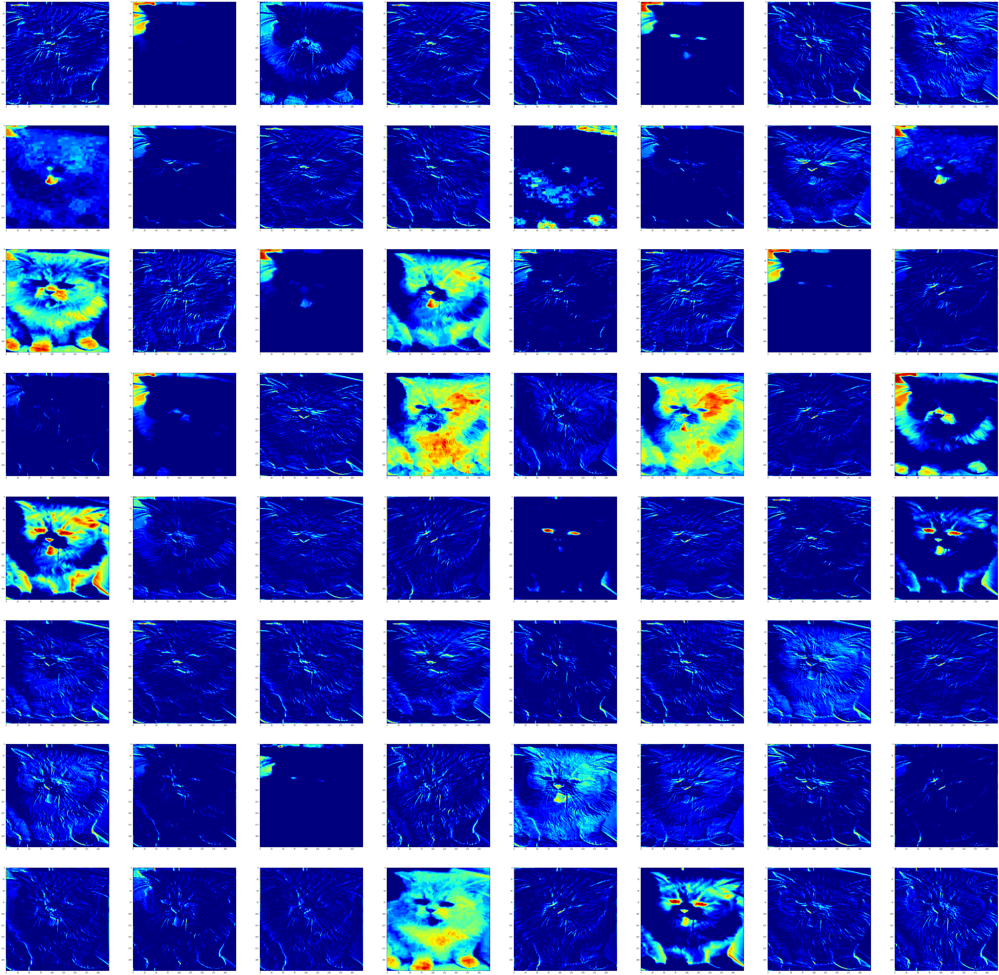

In [121]:
plt.figure(figsize=(100,100))
for i in range(len(feature_maps[0][0][0])):

  image_plt = plt.subplot(8,8, i+1)
  
  plt.imshow(feature_maps[0,:,:,i], cmap="jet")


## 4.2 Image Preparation (from scratch) ##

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(1, 224, 224, 3)

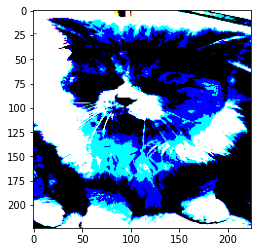

In [171]:
img = cv2.resize(cv2.imread('./assets/images/groupImage.jpg'), (224,224))

img_mean = np.array([  103.939,116.779, 123.68],dtype=np.float32) # [meanR, meanG, meanB]

img = img.astype("float32")
img = img - img_mean

# img = np.where(img >= 0.0, img, 0)
# img = img.astype('uint8')

plt.imshow(img, cmap='jet')
img = img.reshape((1,) + img.shape)
img.shape

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


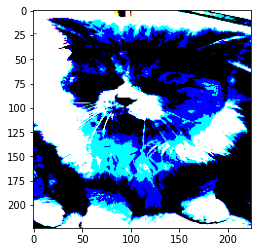

In [161]:
plt.imshow(img_ready[0], cmap='jet')

## 4.3 Cov2D ##

(224, 224, 3)


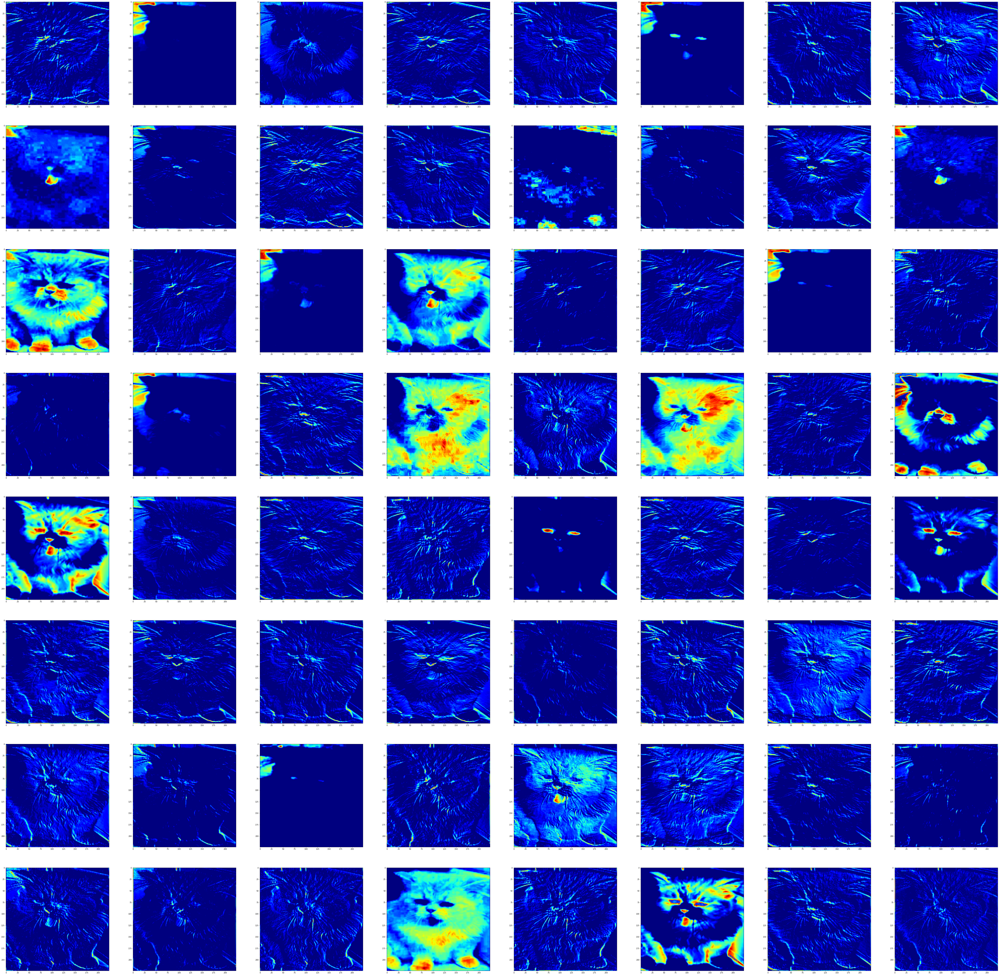

In [166]:
color = ('b','g','r')
img_result = np.zeros((224,224,3))

plt.figure(figsize=(100,100))

for i in range(len(kernels[0,0,0,:])):
  for j, channel in enumerate(color):
    
    img_result[:,:,j] = signal.convolve2d(img[0,:,:,j], kernels[:,:,j,i], mode='same', boundary='fill', fillvalue=0)

  image_sum = img_result[:,:,0] + img_result[:,:,1] + img_result[:,:,2]
  image_sum = np.where(image_sum < 0, 0, image_sum)
  
  image_plot = plt.subplot(8,8,i + 1)
  plt.imshow(image_sum.astype('uint8'), cmap='jet')

print(img_result.shape)